In [1]:
from ultralytics import YOLO
import cv2
from PIL import Image
from IPython.display import display
import numpy as np

In [2]:
# Chose Apple Metal Performance Shaders (MPS) if available, otherwise use CPU
# device = 'mps' if torch.backends.mps.is_available() else 'cpu'

# Use temporary CPU for now. There is some issue with MPS
device = 'cpu'

In [3]:
model = YOLO('runs/detect/train52/weights/best.pt')

In [4]:
img = cv2.imread('data/images/test/6.jpeg')

In [5]:
results = model(img, device=device)

0: 640x480 (no detections), 199.6ms
Speed: 5.1ms preprocess, 199.6ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 480)


[W NNPACK.cpp:64] Could not initialize NNPACK! Reason: Unsupported hardware.


In [6]:
result = results[0]

In [7]:
print(result.names)

{0: 'hold'}


In [8]:
bboxes = np.array(result.boxes.xyxy.cpu(), dtype=int)
classes = np.array(result.boxes.cls.cpu(), dtype=int)

In [13]:
bboxes

array([], shape=(0, 4), dtype=int64)

In [9]:
color = (0, 255, 0)
thickness = 2

for cls, bbox in zip(classes, bboxes):
    x1, y1, x2, y2 = bbox
    
    cv2.rectangle(img, (x1, y1), (x2, y2), color, thickness)
    
    result_name = result.names[cls]
    cv2.putText(img, result_name, (x1, y1 - 5), cv2.FONT_HERSHEY_PLAIN, 1, color, thickness)

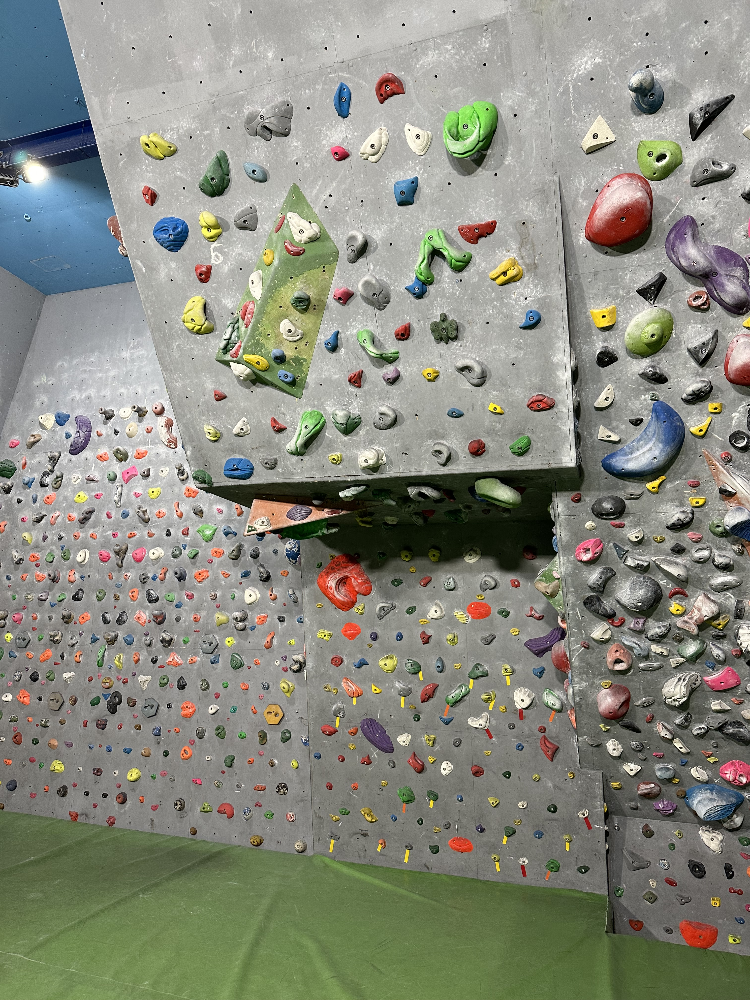

In [10]:
preview = cv2.cvtColor(img, cv2.COLOR_BGR2RGB) # Converting BGR to RGB
display(Image.fromarray(preview))